# Cleaned vs Dirty V2
## Classify if a plate is cleaned or dirty?

## Introduction

In this notebook, we will build a deep learning model to classify images of plates as either cleaned or dirty. The dataset consists of images of plates that are either cleaned or dirty. We will use a pretrained ResNet-18 model and fine-tune it for binary classification.

This is an ultra-small data set, with only 20 cleaned plates and 20 dirty plates.

Data augmentation and pre-trained model was needed to achieve a good accuracy.


## Author

Carlos Alvarado Martinez

# Project URL

Kaggle: [Cleaned vs Dirty Plates](https://www.kaggle.com/competitions/platesv2/overview)

## EDA and Data Preprocessing

Exploratory Data Analysis (EDA) is the process of analyzing and visualizing data to extract insights and identify patterns. Data preprocessing involves cleaning, transforming, and preparing the data for machine learning models.

Data preprocessing steps:
1. Resize and save images to 500 x 500
2. Apply augmentations to increase the size of the training set
3. Create a custom dataset class
4. Split the dataset into training and validation sets
5. Load images using PyTorch's DataLoader
6. Load pretrained ResNet model
7. Modify the model for binary classification
8. Hyperparameter tuning
9. Train and evaluate the model
10. Early stopping
11. Calculate precision, recall, and F1-score
12. Generate submission file
13. Plot the results



## Project Architecture - CNN with RestNet-18

The project uses a convolutional neural network (CNN) based on a pretrained ResNet-18 model.

### ResNet-18 Architecture

ResNet-18 is a deep convolutional neural network that belongs to the family of Residual Networks (ResNets). It was designed to solve the problem of vanishing gradients in very deep networks by introducing residual connections. Here’s an overview of its architecture:

1. **Input Layer:**
   - Accepts input images of size 224x224 (in the project, the images are resized to 500x500).

2. **Convolutional Layers:**
   - The network starts with a 7x7 convolutional layer with 64 filters, followed by a max-pooling layer.

3. **Residual Blocks:**
   - The core of ResNet-18 consists of 8 residual blocks. Each block has two convolutional layers with a shortcut connection that adds the input of the block to its output. This helps in preserving the gradient during backpropagation.

4. **Global Average Pooling:**
   - After the residual blocks, a global average pooling layer reduces each feature map to a single value, which reduces the total number of parameters and helps in preventing overfitting.

5. **Fully Connected Layer:**
   - The output from the global average pooling layer is fed into a fully connected (dense) layer that produces the final class scores.

### Modifications for the Project 

In the project, the ResNet-18 model has been fine-tuned for the specific task of binary classification (cleaned vs. dirty plates):

1. **Input Layer:**
   - The input images are resized to 500x500 before being fed into the network.

2. **First Convolutional Layer:**
   - The first convolutional layer of the ResNet-18 is modified to accept 500x500 input images.

3. **Final Fully Connected Layer:**
   - The original fully connected layer, which is designed for 1000-class classification (as in ImageNet), is replaced with a new fully connected layer with 2 outputs (cleaned and dirty).

### Training Process

1. **Data Augmentation:**
   - Various augmentations such as resizing, horizontal and vertical flipping, rotation, and color jittering are applied to the training images to increase the diversity of the training set.

2. **Fine-tuning:**
   - The pretrained weights of ResNet-18 are used, and the model is fine-tuned on the specific dataset. Fine-tuning involves training the network on the data with a small learning rate, allowing the model to adapt the pretrained features to the specific task.

3. **Loss Function:**
   - Cross-entropy loss is used as the loss function, which is standard for classification problems.

4. **Optimizer:**
   - Optimizers like Adam or SGD are used to update the model weights during training. The learning rate and other hyperparameters are tuned to achieve the best performance.

5. **Early Stopping:**
   - Early stopping is implemented to prevent overfitting. Training is stopped when the validation loss stops improving for a certain number of epochs.

### Evaluation Metrics

During training, the model's performance is evaluated using metrics such as accuracy, precision, recall, and F1-score. These metrics help in understanding how well the model is performing in classifying the images correctly.

### Summary

The neural network used in the project is a modified version of the ResNet-18, a deep convolutional neural network known for its residual connections that allow for the training of very deep networks. By fine-tuning this pretrained model on the dataset of cleaned and dirty plates, the network learns to accurately classify the images, leveraging the power of transfer learning and data augmentation to handle the small dataset size effectively.

Number of cleaned plates: 20
Number of dirty plates: 20
Cleaned plates:


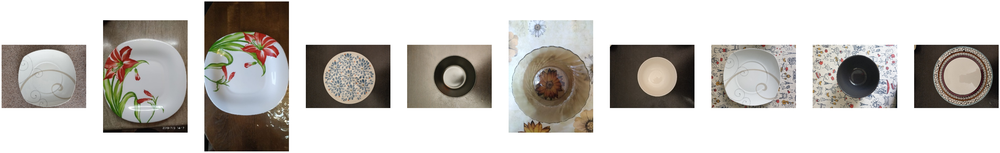

Dirty plates:


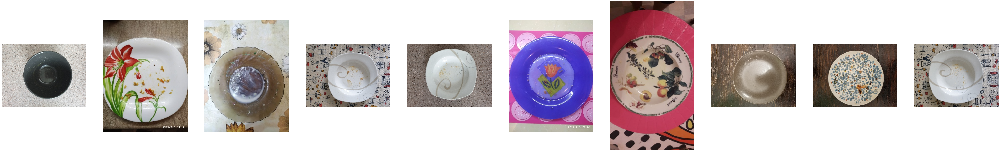

Number of test images: 745
Test images:


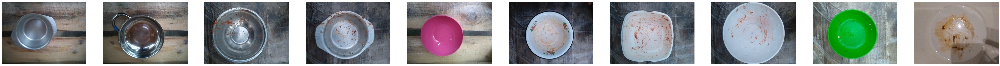

In [1]:
# Explore the dataset
import os
import pandas as pd

# Show 10 images from the training set
train_dir = './plates/train'
train_cleaned_dir = os.path.join(train_dir, 'cleaned')
train_dirty_dir = os.path.join(train_dir, 'dirty')

print(f"Number of cleaned plates: {len(os.listdir(train_cleaned_dir))}")
print(f"Number of dirty plates: {len(os.listdir(train_dirty_dir))}")

# Plot 10 images from the cleaned plates with plot_images function
import matplotlib.pyplot as plt
from PIL import Image

# Skip .DS_Store file on macOS
def plot_images(image_dir, num_images=10):
    images = os.listdir(image_dir)
    fig, axes = plt.subplots(1, num_images, figsize=(80, 40))
    for i, img_name in enumerate(images[:num_images]):
        img_path = os.path.join(image_dir, img_name)
        img = Image.open(img_path)
        axes[i].imshow(img)
        axes[i].axis('off')
    plt.show()
    
print("Cleaned plates:")
plot_images(train_cleaned_dir)

print("Dirty plates:")
plot_images(train_dirty_dir)

# Show 10 images from the test set
test_dir = './plates/test'
print(f"Number of test images: {len(os.listdir(test_dir))}")
print("Test images:")
plot_images(test_dir)



Cleaned plates:


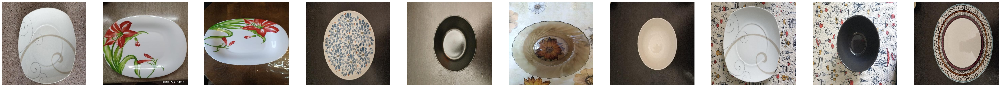

Dirty plates:


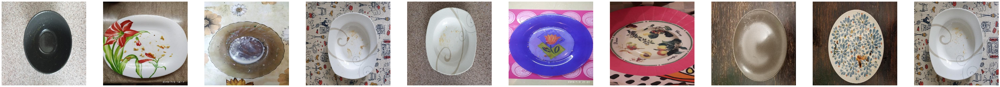

In [2]:
# Resize and save images to 500 x 500 all of them
# Example to resize one image to 500 x 500

import torch
from torch.utils.data import DataLoader, Dataset
from torchvision import transforms, models
from PIL import Image, UnidentifiedImageError
import os
import numpy as np
import pandas as pd
import torch.nn as nn
import torch.optim as optim
from sklearn.model_selection import train_test_split

# Function to resize images
def resize_and_save_images(input_dir, output_dir, size=(500, 500), labels=None):
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)
    if labels is None:
        # For test set which is flat
        for img_name in os.listdir(input_dir):
            img_path = os.path.join(input_dir, img_name)
            try:
                img = Image.open(img_path)
                img = img.resize(size, Image.LANCZOS)
                img.save(os.path.join(output_dir, img_name))
            except UnidentifiedImageError:
                print(f"Skipping file {img_path} as it is not a valid image")
    else:
        # For train set with labels
        for label in labels:
            label_dir = os.path.join(input_dir, label)
            output_label_dir = os.path.join(output_dir, label)
            if not os.path.exists(output_label_dir):
                os.makedirs(output_label_dir)
            for img_name in os.listdir(label_dir):
                img_path = os.path.join(label_dir, img_name)
                try:
                    img = Image.open(img_path)
                    img = img.resize(size, Image.LANCZOS)
                    img.save(os.path.join(output_label_dir, img_name))
                except UnidentifiedImageError:
                    print(f"Skipping file {img_path} as it is not a valid image")
                    
                    
# Generate one image resized
original_train_dir = './plates/train'
resized_train_dir = './plates_resized/train'

resize_and_save_images(original_train_dir, resized_train_dir, labels=['cleaned'])

# Plot 10 images from the cleaned plates with plot_images function
train_cleaned_resized_dir = os.path.join(resized_train_dir, 'cleaned')
print("Cleaned plates:")
plot_images(train_cleaned_resized_dir)

# do the same for dirty plates
resize_and_save_images(original_train_dir, resized_train_dir, labels=['dirty'])

train_dirty_resized_dir = os.path.join(resized_train_dir, 'dirty')
print("Dirty plates:")
plot_images(train_dirty_resized_dir)


In [3]:
# Function to apply augmentations and save images
def augment_and_save_images(input_dir, output_dir, augmentations, num_augments=600):
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)
    for label in ['cleaned', 'dirty']:
        label_dir = os.path.join(input_dir, label)
        output_label_dir = os.path.join(output_dir, label)
        if not os.path.exists(output_label_dir):
            os.makedirs(output_label_dir)
        images = [os.path.join(label_dir, img_name) for img_name in os.listdir(label_dir)]
        for img_path in images:
            try:
                img = Image.open(img_path)
                for i in range(num_augments):
                    augmented_img = augmentations(img)
                    # Convert tensor back to PIL image
                    augmented_img = transforms.ToPILImage()(augmented_img)
                    augmented_img.save(os.path.join(output_label_dir, f"{os.path.basename(img_path).split('.')[0]}_{i}.png"))
            except UnidentifiedImageError:
                print(f"Skipping file {img_path} as it is not a valid image")

# Directories
original_train_dir = './plates/train'
resized_train_dir = './plates_resized/train'
original_test_dir = './plates/test'
resized_test_dir = './plates_resized/test'
augmented_train_dir = './plates_augmented/train'

# Resize and save images
resize_and_save_images(original_train_dir, resized_train_dir, labels=['cleaned', 'dirty'])
resize_and_save_images(original_test_dir, resized_test_dir)

Skipping file ./plates/test/.DS_Store as it is not a valid image


## Data Augmentation

Data augmentation is a technique used to increase the size of the training set by applying random transformations to the images. This helps the model generalize better and reduces overfitting.



Cleaned plates with augmentation:


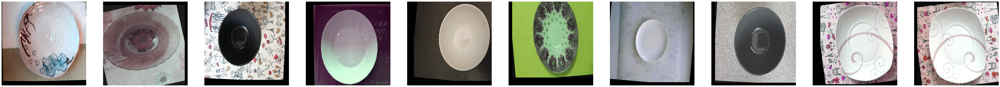

Dirty plates with augmentation:


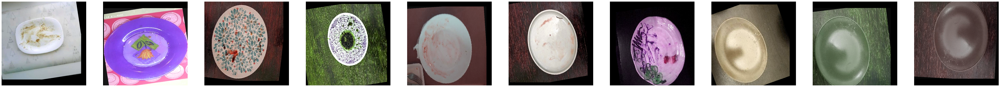

In [4]:
# Augmentation transforms
augmentations = transforms.Compose([
    transforms.Resize((500, 500)),
    transforms.RandomHorizontalFlip(),
    transforms.RandomVerticalFlip(),
    transforms.RandomRotation(20),
    transforms.ColorJitter(brightness=0.3, contrast=0.3, saturation=0.3, hue=0.3),
    transforms.RandomAffine(degrees=0, translate=(0.1, 0.1)),
    transforms.ToTensor(),
])

# Apply augmentations and save images
augment_and_save_images(resized_train_dir, augmented_train_dir, augmentations, num_augments=20)

# Plot 10 augmented images from the cleaned plates
train_cleaned_augmented_dir = os.path.join(augmented_train_dir, 'cleaned')
print("Cleaned plates with augmentation:")
plot_images(train_cleaned_augmented_dir)

# Plot 10 augmented images from the dirty plates
train_dirty_augmented_dir = os.path.join(augmented_train_dir, 'dirty')
print("Dirty plates with augmentation:")
plot_images(train_dirty_augmented_dir)


In [5]:
# Dataset class
class PlatesDataset(Dataset):
    def __init__(self, image_paths, labels=None, transform=None, is_test=False):
        self.image_paths = image_paths
        self.labels = labels
        self.transform = transform
        self.is_test = is_test
    
    def __len__(self):
        return len(self.image_paths)
    
    def __getitem__(self, idx):
        img_path = self.image_paths[idx]
        image = Image.open(img_path)
        if self.transform:
            image = self.transform(image)
        if self.is_test:
            return image, img_path  # Return image and path for test set
        else:
            label = self.labels[idx]
            return image, label

# Transformations for training and testing datasets
train_transform = transforms.Compose([
    transforms.Resize((500, 500)),
    transforms.RandomHorizontalFlip(),
    transforms.RandomVerticalFlip(),
    transforms.RandomRotation(20),
    transforms.ColorJitter(brightness=0.3, contrast=0.3, saturation=0.3, hue=0.3),
    transforms.RandomAffine(degrees=0, translate=(0.1, 0.1)),
    transforms.ToTensor(),
])

test_transform = transforms.Compose([
    transforms.Resize((500, 500)),
    transforms.ToTensor(),
])

# List all images and labels
image_paths = []
labels = []
for label in ['cleaned', 'dirty']:
    image_dir = os.path.join(augmented_train_dir, label)
    for img_name in os.listdir(image_dir):
        img_path = os.path.join(image_dir, img_name)
        try:
            Image.open(img_path)  # Attempt to open the image to verify it's valid
            image_paths.append(img_path)
            labels.append(0 if label == 'cleaned' else 1)
        except UnidentifiedImageError:
            print(f"Skipping file {img_path} as it is not a valid image")

## Hyperparameter Tuning

Hyperparameter tuning is the process of finding the best set of hyperparameters for a machine learning model. Hyperparameters are parameters that are set before the learning process begins, such as the learning rate, batch size, and optimizer. Tuning these hyperparameters can significantly impact the performance of the model.


Best parameters: {'weight_decay': 0, 'optimizer': <class 'torch.optim.adam.Adam'>, 'lr': 1e-05, 'batch_size': 16}
Best validation accuracy: 0.65


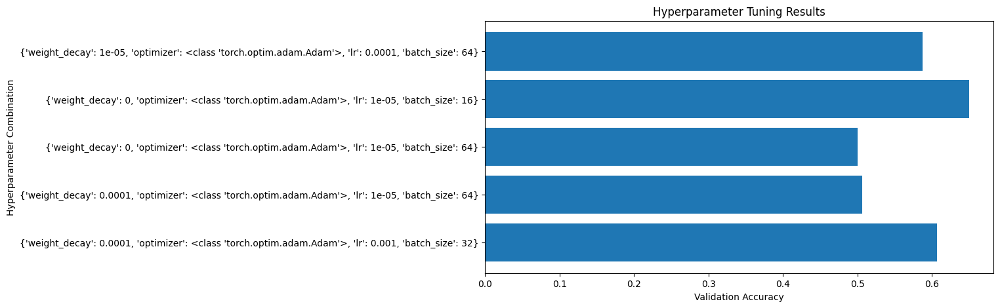

In [6]:
import torch
from torch.utils.data import DataLoader, Dataset
from torchvision import transforms, models
from PIL import Image, UnidentifiedImageError
import os
import numpy as np
import pandas as pd
import torch.nn as nn
import torch.optim as optim
from sklearn.model_selection import train_test_split, ParameterSampler
from sklearn.metrics import accuracy_score
import matplotlib.pyplot as plt
import random

# Hyperparameter space
param_grid = {
    'lr': [1e-3, 1e-4, 1e-5],
    'batch_size': [16, 32, 64],
    'optimizer': [optim.Adam, optim.SGD],
    'weight_decay': [0, 1e-4, 1e-5]
}

# Generate random parameter combinations
param_list = list(ParameterSampler(param_grid, n_iter=5, random_state=42))


# Function to create model
def create_model():
    model = models.resnet18()
    model.conv1 = nn.Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    num_features = model.fc.in_features
    model.fc = nn.Linear(num_features, 2)
    return model

# Function to train and evaluate model
def train_and_evaluate(params, train_loader, val_loader):
    model = create_model()
    criterion = nn.CrossEntropyLoss()
    optimizer = params['optimizer'](model.parameters(), lr=params['lr'], weight_decay=params['weight_decay'])
    scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min', patience=2)
    
    best_val_accuracy = 0
    num_epochs = 3
    for epoch in range(num_epochs):
        model.train()
        for images, labels in train_loader:
            optimizer.zero_grad()
            outputs = model(images)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()
        
        model.eval()
        val_predictions = []
        val_labels = []
        with torch.no_grad():
            for images, labels in val_loader:
                outputs = model(images)
                _, predicted = torch.max(outputs, 1)
                val_predictions.extend(predicted.cpu().numpy())
                val_labels.extend(labels.cpu().numpy())
        
        val_accuracy = accuracy_score(val_labels, val_predictions)
        if val_accuracy > best_val_accuracy:
            best_val_accuracy = val_accuracy
    
    return best_val_accuracy

# Split into training and validation sets
train_paths, val_paths, train_labels, val_labels = train_test_split(
    image_paths, labels, test_size=0.2, stratify=labels, random_state=42)

# Create datasets and dataloaders
train_dataset = PlatesDataset(train_paths, train_labels, transform=train_transform)
val_dataset = PlatesDataset(val_paths, val_labels, transform=test_transform)

# Perform random search
best_params = None
best_accuracy = 0
results = []

for params in param_list:
    batch_size = params['batch_size']
    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
    val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
    
    val_accuracy = train_and_evaluate(params, train_loader, val_loader)
    results.append((params, val_accuracy))
    
    if val_accuracy > best_accuracy:
        best_accuracy = val_accuracy
        best_params = params

print("Best parameters:", best_params)
print("Best validation accuracy:", best_accuracy)

# Plotting the results
params_list = [str(param) for param, acc in results]
acc_list = [acc for param, acc in results]

plt.figure(figsize=(10, 5))
plt.barh(params_list, acc_list)
plt.xlabel('Validation Accuracy')
plt.ylabel('Hyperparameter Combination')
plt.title('Hyperparameter Tuning Results')
plt.show()


In [7]:
import torch
from torch.utils.data import DataLoader, Dataset
from torchvision import transforms, models
from PIL import Image, UnidentifiedImageError
import os
import numpy as np
import pandas as pd
import torch.nn as nn
import torch.optim as optim
from sklearn.model_selection import train_test_split, ParameterSampler
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
import matplotlib.pyplot as plt



# Split into training and validation sets
train_paths, val_paths, train_labels, val_labels = train_test_split(
    image_paths, labels, test_size=0.2, stratify=labels, random_state=42)

# Create datasets and dataloaders with the best batch size
train_dataset = PlatesDataset(train_paths, train_labels, transform=train_transform)
val_dataset = PlatesDataset(val_paths, val_labels, transform=test_transform)
train_loader = DataLoader(train_dataset, batch_size=best_params['batch_size'], shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=best_params['batch_size'], shuffle=False)

test_image_paths = [os.path.join(resized_test_dir, img_name) for img_name in os.listdir(resized_test_dir)]
valid_test_image_paths = []
for img_path in test_image_paths:
    try:
        Image.open(img_path)  # Verify if the image is valid
        valid_test_image_paths.append(img_path)
    except UnidentifiedImageError:
        print(f"Skipping file {img_path} as it is not a valid image")

test_dataset = PlatesDataset(valid_test_image_paths, transform=test_transform, is_test=True)
test_loader = DataLoader(test_dataset, batch_size=best_params['batch_size'], shuffle=False)

# Load pretrained ResNet model manually
model = models.resnet18()
model.load_state_dict(torch.load('./resnet18-f37072fd.pth'))

# Modify the first layer to accept 500x500 input
model.conv1 = nn.Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)

# Modify the final layer for binary classification
num_features = model.fc.in_features
model.fc = nn.Linear(num_features, 2)

# Use the best optimizer and learning rate
optimizer = best_params['optimizer'](model.parameters(), lr=best_params['lr'], weight_decay=best_params['weight_decay'])
criterion = nn.CrossEntropyLoss()
scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min', patience=2)

# Early stopping parameters
early_stop_patience = 5
best_val_loss = float('inf')
patience_counter = 0

# Add lists to store precision, recall, and F1-score if computed
precisions = []
recalls = []
f1_scores = []
train_losses = []
val_losses = []
val_accuracies = []


## Train and Evaluate the Model

Training a deep learning model involves feeding the model with training data, computing the loss, and updating the model's weights to minimize the loss. The model is then evaluated on a separate validation set to check its performance. The training process is repeated for multiple epochs until the model converges.



In [8]:

# Training loop
num_epochs = 10
for epoch in range(num_epochs):
    model.train()
    running_loss = 0.0
    for images, labels in train_loader:
        optimizer.zero_grad()
        outputs = model(images)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()
        running_loss += loss.item()
    train_losses.append(running_loss / len(train_loader))  # Store training loss
    print(f'Epoch {epoch + 1}, Loss: {running_loss / len(train_loader)}')

    model.eval()
    val_loss = 0.0
    correct = 0
    total = 0
    all_labels = []
    all_predictions = []
    with torch.no_grad():
        for images, labels in val_loader:
            outputs = model(images)
            loss = criterion(outputs, labels)
            val_loss += loss.item()
            _, predicted = torch.max(outputs, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()
            all_labels.extend(labels.cpu().numpy())
            all_predictions.extend(predicted.cpu().numpy())
    val_loss /= len(val_loader)
    val_losses.append(val_loss)  # Store validation loss
    val_accuracy = 100 * correct / total
    val_accuracies.append(val_accuracy)  # Store validation accuracy
    print(f'Validation Loss: {val_loss}, Accuracy: {val_accuracy}%')

    # Calculate precision, recall, and F1-score
    precision = precision_score(all_labels, all_predictions, average='binary')
    recall = recall_score(all_labels, all_predictions, average='binary')
    f1 = f1_score(all_labels, all_predictions, average='binary')
    precisions.append(precision)
    recalls.append(recall)
    f1_scores.append(f1)

    # Check for early stopping
    if val_loss < best_val_loss:
        best_val_loss = val_loss
        patience_counter = 0
        torch.save(model.state_dict(), 'best_model.pth')
    else:
        patience_counter += 1
        if patience_counter >= early_stop_patience:
            print("Early stopping triggered")
            break

    # Step the scheduler
    scheduler.step(val_loss)
    print(f"Current learning rate: {scheduler.get_last_lr()[0]}")


Epoch 1, Loss: 0.7794087424874305
Validation Loss: 0.6877398550510406, Accuracy: 58.75%
Current learning rate: 1e-05
Epoch 2, Loss: 0.6012548610568047
Validation Loss: 0.5182138204574585, Accuracy: 74.375%
Current learning rate: 1e-05
Epoch 3, Loss: 0.4781716883182526
Validation Loss: 0.3960824370384216, Accuracy: 84.375%
Current learning rate: 1e-05
Epoch 4, Loss: 0.37408660911023617
Validation Loss: 0.2595095902681351, Accuracy: 97.5%
Current learning rate: 1e-05
Epoch 5, Loss: 0.28605311512947085
Validation Loss: 0.1951235830783844, Accuracy: 96.25%
Current learning rate: 1e-05
Epoch 6, Loss: 0.2474471377208829
Validation Loss: 0.1577189326286316, Accuracy: 97.5%
Current learning rate: 1e-05
Epoch 7, Loss: 0.21833309363573788
Validation Loss: 0.10758239328861237, Accuracy: 98.75%
Current learning rate: 1e-05
Epoch 8, Loss: 0.176469692774117
Validation Loss: 0.07432955913245679, Accuracy: 99.375%
Current learning rate: 1e-05
Epoch 9, Loss: 0.15905068097636105
Validation Loss: 0.06184

## Plot the Results

Visualizing the results of training and evaluating the model can help us understand how the model is performing. We can plot the training and validation loss, validation accuracy, precision, recall, and F1-score to see how they change over time.


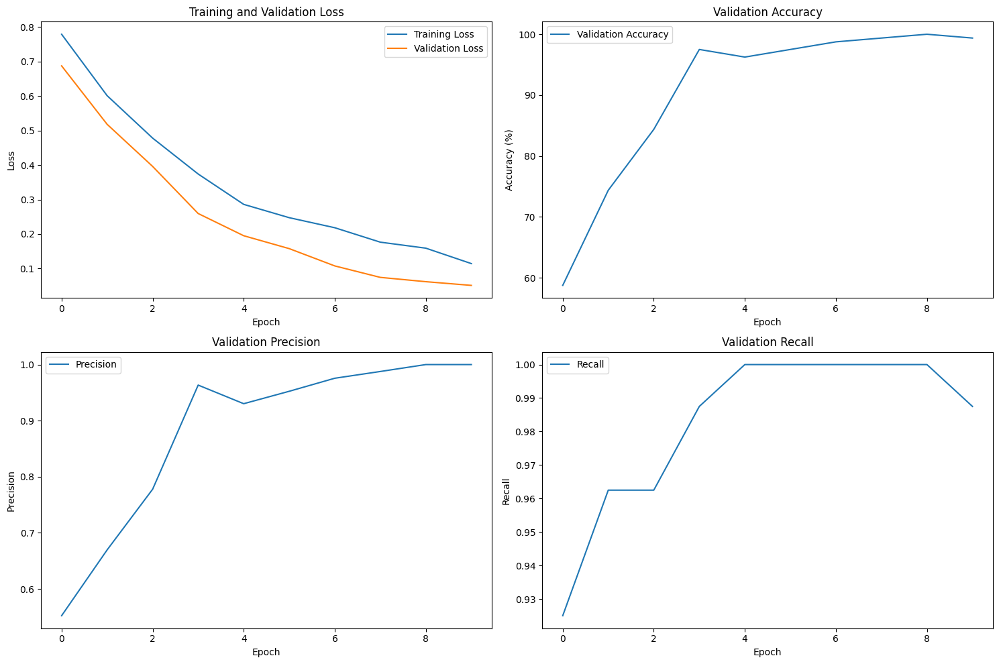

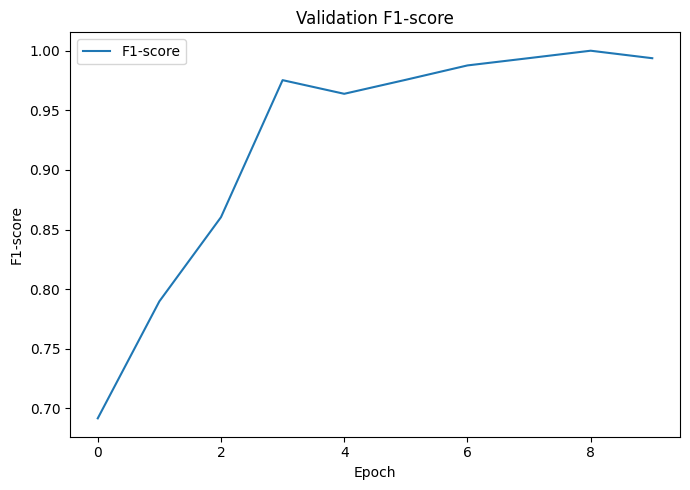

In [9]:

# Plotting the results
plt.figure(figsize=(15, 10))

# Training and validation loss plot
plt.subplot(2, 2, 1)
plt.plot(train_losses, label='Training Loss')
plt.plot(val_losses, label='Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training and Validation Loss')
plt.legend()

# Validation accuracy plot
plt.subplot(2, 2, 2)
plt.plot(val_accuracies, label='Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy (%)')
plt.title('Validation Accuracy')
plt.legend()

# Precision plot
plt.subplot(2, 2, 3)
plt.plot(precisions, label='Precision')
plt.xlabel('Epoch')
plt.ylabel('Precision')
plt.title('Validation Precision')
plt.legend()

# Recall plot
plt.subplot(2, 2, 4)
plt.plot(recalls, label='Recall')
plt.xlabel('Epoch')
plt.ylabel('Recall')
plt.title('Validation Recall')
plt.legend()

plt.tight_layout()
plt.show()

# F1-score plot
plt.figure(figsize=(7, 5))
plt.plot(f1_scores, label='F1-score')
plt.xlabel('Epoch')
plt.ylabel('F1-score')
plt.title('Validation F1-score')
plt.legend()

plt.tight_layout()
plt.show()


In [10]:
# Generate submission file
# Load model from best_model.pth local file
model = models.resnet18()

# Modify the first layer to accept 500x500 input
model.conv1 = nn.Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)

# Modify the final layer for binary classification
num_features = model.fc.in_features
model.fc = nn.Linear(num_features, 2)

# Load the state dictionary
model.load_state_dict(torch.load('./best_model.pth'))

# Set model to evaluation mode
model.eval()

predictions = []
image_paths = []

with torch.no_grad():
    for images, paths in test_loader:
        outputs = model(images)
        _, predicted = torch.max(outputs, 1)
        predictions.extend(predicted.cpu().numpy())
        image_paths.extend(paths)

# Prepare submission DataFrame
test_image_names = [os.path.splitext(os.path.basename(path))[0] for path in image_paths]
submission = pd.DataFrame({'id': test_image_names, 'label': ['cleaned' if pred == 0 else 'dirty' for pred in predictions]})

# Sort the DataFrame by 'id'
submission = submission.sort_values(by='id')

# Save the sorted DataFrame to CSV
submission.to_csv('submission-best.csv', index=False)


## Conclusion

In this notebook, we built a deep learning model to classify images of plates as either cleaned or dirty. We used a pretrained ResNet-18 model and fine-tuned it for binary classification. We performed data augmentation to increase the size of the training set and hyperparameter tuning to find the best set of hyperparameters for the model. We trained the model, evaluated its performance, and visualized the results. Finally, we generated a submission file for the Kaggle competition.
